# Bias Mitigation Analysis - Adult

In [1]:
data_name = 'Adult'

In [2]:
# define desired metric for the use case
ACC_METRIC = 'avg_norm_mcc_score'
FAIR_METRIC = 'abs_avg_spd_score'

In [3]:
import os
import pandas as pd
results_all = pd.DataFrame()
dir_path = './{}_results/'.format(data_name)
for file in os.listdir(dir_path):
    print(file)
    result = pd.read_pickle(dir_path+file)
    results_all = pd.concat([results_all, result])

Adult_results_GB
Adult_results_NB
Adult_results_SVM_RWCEO
Adult_results_SVM_EGR4
Adult_results_SVM_EGR3
Adult_results_TabTrans_RW+CEO
Adult_results_SVM_EGR
Adult_results_SVM_EGR2
Adult_results_TabTrans_ROC
Adult_results_SVM_CEO
Adult_results_LR
Adult_results_TabTrans_None
Adult_results_SVM_LFR_pre2
Adult_results_SVM_None
Adult_results_SVM_RW
Adult_results_SVM_ROC
Adult_results_SVM_LFR_pre
Adult_results_TabTrans_RW
Adult_results_TabTrans_CEO
Adult_results_TabTrans_RW+ROC
Adult_results_RF
Adult_results_SVM_RWROC


In [4]:
print(results_all.shape)
results_all.head(2)

(960, 19)


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, ...",None,0.3,0.840033,0.817719,0.699677,0.914909,0.597697,0.798848,-0.156204,-0.048729,-0.017521,-0.047658,-0.037363,0.091459,0.071021,0.089088,0.357355
1,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, ...",None,0.4,0.861649,0.766765,0.670042,0.914909,0.595316,0.797658,-0.112241,-0.061248,-0.088343,-0.063344,-0.011599,0.066179,0.076407,0.120353,0.314583


In [5]:
import seaborn as sns
accuracy_metrics = ['acc_score', 'bacc_score', 'f1_score', 'auc_score', 'mcc_score','norm_mcc_score']
group_fairness = ['spd_score', 'aod_score', 'eod_score','ford_score','ppvd_score']
individual_fairness = ['(1-consistency_score)','gei_score','ti_score']
fairness_metrics = group_fairness+individual_fairness
avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]

In [6]:
results_all_converted = results_all.copy(deep=True) 
for col in avg_fairness_metrics:
    abs_col_name = 'abs_'+col
    results_all_converted[abs_col_name] = results_all_converted[col].abs()
results_all_converted.head()

,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,...,avg_ti_score,cost,abs_avg_spd_score,abs_avg_aod_score,abs_avg_eod_score,abs_avg_ford_score,abs_avg_ppvd_score,abs_avg_(1-consistency_score),abs_avg_gei_score,abs_avg_ti_score
0,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, ...",None,0.3,0.840033,0.817719,0.699677,0.914909,0.597697,0.798848,...,0.089088,0.357355,0.156204,0.048729,0.017521,0.047658,0.037363,0.091459,0.071021,0.089088
1,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, ...",None,0.4,0.861649,0.766765,0.670042,0.914909,0.595316,0.797658,...,0.120353,0.314583,0.112241,0.061248,0.088343,0.063344,0.011599,0.066179,0.076407,0.120353
2,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, ...",None,0.5,0.856847,0.728565,0.617933,0.914909,0.573260,0.786630,...,0.140999,0.297318,0.083948,0.040510,0.064240,0.078140,0.002506,0.061110,0.082546,0.140999
3,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, ...",None,0.6,0.823584,0.634444,0.423803,0.914909,0.463684,0.731842,...,0.193504,0.304296,0.036137,0.002379,0.005948,0.108871,0.012515,0.048692,0.107109,0.193504
4,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, ...",None,0.7,0.818718,0.623811,0.396973,0.914909,0.445112,0.722556,...,0.199698,0.309495,0.032051,0.005594,0.011832,0.111769,0.007456,0.046461,0.110716,0.199698


In [7]:
results_all_converted.base_estimator.value_counts()

LR          200
GB          160
NB          160
SVM         160
RF          160
TabTrans    120
Name: base_estimator, dtype: int64

In [8]:
# BEST MODELS
scoring = (ACC_METRIC,FAIR_METRIC,1,1)
w_acc = scoring[2]
w_fair = scoring[3]
acc_cost = 1-results_all_converted[ACC_METRIC]
fair_cost = abs(results_all_converted[FAIR_METRIC])

results_all_converted['cost'] = w_acc*acc_cost + w_fair*fair_cost
results_all_converted.sort_values(by='cost')[['base_estimator','param','Bias_Mitigation','threshold',
                                                      ACC_METRIC,FAIR_METRIC,'cost']].drop_duplicates(subset='cost').head(5)

,base_estimator,param,Bias_Mitigation,threshold,avg_norm_mcc_score,abs_avg_spd_score,cost
71,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, ...",RW+ROC,0.4,0.811452,0.009076,0.197624
72,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, ...",RW+ROC,0.5,0.802804,0.005985,0.203181
140,RF,"{'criterion': 'entropy', 'max_depth': 16, 'n_e...",ROC,0.3,0.799473,0.004042,0.204569
70,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, ...",RW+ROC,0.3,0.814374,0.019775,0.205401
60,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_esti...",ROC,0.3,0.800675,0.006479,0.205804


## Analysis like in Chen et al. (2023)

In [9]:
diff_dict = {}
for base in results_all_converted.base_estimator.unique():
    None_table = results_all_converted[(results_all_converted.base_estimator==base)&
                                       (results_all_converted.Bias_Mitigation=='None')].reset_index(drop=True)
    diff_dict[base] = {}
    for BM in results_all_converted[results_all_converted.base_estimator==base].Bias_Mitigation.unique():
        if BM == 'None': pass
        else: 
            # print(BM)
            BM_subtable = results_all_converted[(results_all_converted.base_estimator==base)&
                                                (results_all_converted.Bias_Mitigation==BM)].reset_index(drop=True)
            diff_table = BM_subtable.iloc[:,:4]
            diff_table = pd.concat([diff_table,BM_subtable.iloc[:,4:].subtract(None_table.iloc[:,4:])], axis=1)
            diff_dict[base][BM] = diff_table

In [10]:
df = pd.DataFrame()
for base in diff_dict.keys():
    sub_df = pd.concat(diff_dict[base])
    df = pd.concat([df, pd.concat(diff_dict[base])])
df

base_estimator                                              param  \
RW     0              GB  {'criterion': 'friedman_mse', 'max_depth': 8, ...   
       1              GB  {'criterion': 'friedman_mse', 'max_depth': 8, ...   
       2              GB  {'criterion': 'friedman_mse', 'max_depth': 8, ...   
       3              GB  {'criterion': 'friedman_mse', 'max_depth': 8, ...   
       4              GB  {'criterion': 'friedman_mse', 'max_depth': 8, ...   
...                  ...                                                ...   
RW+CEO 15             RF  {'criterion': 'entropy', 'max_depth': 16, 'n_e...   
       16             RF  {'criterion': 'entropy', 'max_depth': 16, 'n_e...   
       17             RF  {'criterion': 'entropy', 'max_depth': 16, 'n_e...   
       18             RF  {'criterion': 'entropy', 'max_depth': 16, 'n_e...   
       19             RF  {'criterion': 'entropy', 'max_depth': 16, 'n_e...   

          Bias_Mitigation  threshold  avg_acc_score  avg_bacc_score  \
RW     0               RW        0.3      -0.002002       -0.001380   
       1               RW        0.4       0.000194        0.000862   
       2               RW        0.5      -0.000495       -0.000998   
       3               RW        0.6       0.000172        0.000326   
       4               RW        0.7      -0.000883       -0.001804   
...                   ...        ...            ...             ...   
RW+CEO 15          RW+CEO        0.3      -0.000043       -0.015959   
       16          RW+CEO        0.4      -0.003574       -0.015043   
       17          RW+CEO        0.5      -0.003811       -0.011957   
       18          RW+CEO        0.6      -0.004349       -0.012005   
       19          RW+CEO        0.7      -0.005189       -0.012161   

           avg_f1_score  avg_auc_score  avg_mcc_score  avg_norm_mcc_score  \
RW     0      -0.002687      -0.000658      -0.003642           -0.001821   
       1       0.001070      -0.000658       0.000792            0.000396   
       2      -0.001867      -0.000658      -0.001646           -0.000823   
       3       0.000809      -0.000658       0.000699            0.000349   
       4      -0.004592      -0.000658      -0.003556           -0.001778   
...                 ...            ...            ...                 ...   
RW+CEO 15     -0.012157      -0.014228      -0.018972           -0.009486   
       16     -0.017185      -0.014228      -0.017135           -0.008567   
       17     -0.017246      -0.014228      -0.014124           -0.007062   
       18     -0.020341      -0.014228      -0.015009           -0.007505   
       19     -0.026140      -0.014228      -0.018425           -0.009212   

           ...  avg_ti_score      cost  abs_avg_spd_score  abs_avg_aod_score  \
RW     0   ...      0.000494 -0.035436          -0.037257          -0.045284   
       1   ...     -0.000463 -0.037582          -0.037186          -0.041324   
       2   ...      0.000554 -0.003979          -0.004802          -0.011564   
       3   ...     -0.000193 -0.000689          -0.000340           0.000723   
       4   ...      0.001061  0.002069           0.000291          -0.003063   
...        ...           ...       ...                ...                ...   
RW+CEO 15  ...      0.009810  0.160813           0.151328           0.412376   
       16  ...      0.008266  0.100726           0.092158           0.299281   
       17  ...      0.006506  0.074592           0.067529           0.233792   
       18  ...      0.006592  0.056894           0.049389           0.188478   
       19  ...      0.006895  0.040184           0.030972           0.129587   

           abs_avg_eod_score  abs_avg_ford_score  abs_avg_ppvd_score  \
RW     0            0.037284            0.009684            0.070350   
       1           -0.036814            0.017015            0.095257   
       2           -0.020956            0.002695            0.019973   
       3            0.001139      

In [11]:
(df.iloc[:,4:10]>0).sum()/df.shape[0]

avg_acc_score         0.316667
avg_bacc_score        0.135714
avg_f1_score          0.152381
avg_auc_score         0.041667
avg_mcc_score         0.177381
avg_norm_mcc_score    0.177381
dtype: float64

In [12]:
(df[df.Bias_Mitigation=='RW'].avg_norm_mcc_score>0).value_counts(normalize=True)

False    0.675
True     0.325
Name: avg_norm_mcc_score, dtype: float64

### Accuracy Behavior After Bias Mitigations

In [13]:
from analysis_utils import *
%matplotlib inline

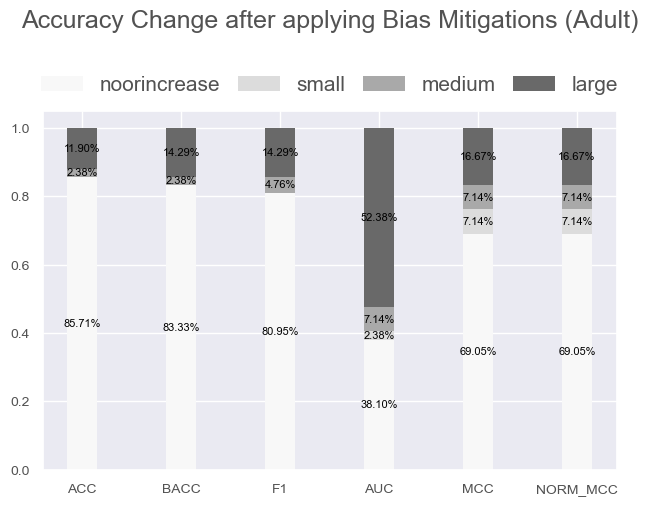

In [14]:
diff_degree, table = behaviour_analysis(data=results_all_converted, metric_list=avg_accuracy_metrics)
plot_behaviour_analysis(table, caption='Accuracy Change after applying Bias Mitigations ({})'.format(data_name))

### Accuracy Behavior After Bias Mitigations per BM

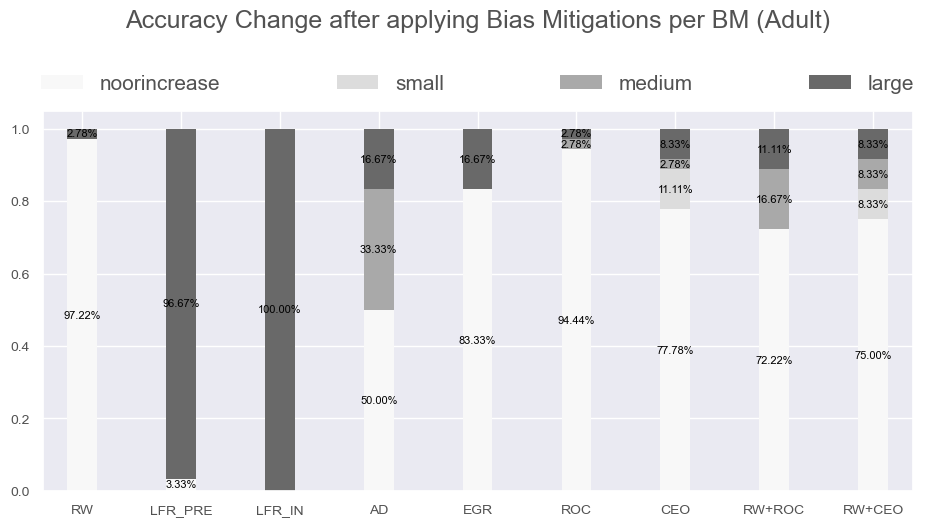

In [15]:
diff_degree, table = behaviour_analysis(data=results_all_converted, metric_list=avg_accuracy_metrics, category='bm')
plot_behaviour_analysis(table, caption='Accuracy Change after applying Bias Mitigations per BM ({})'.format(data_name), figsize=(12, 6))

### Accuracy Behavior After Bias Mitigations per base

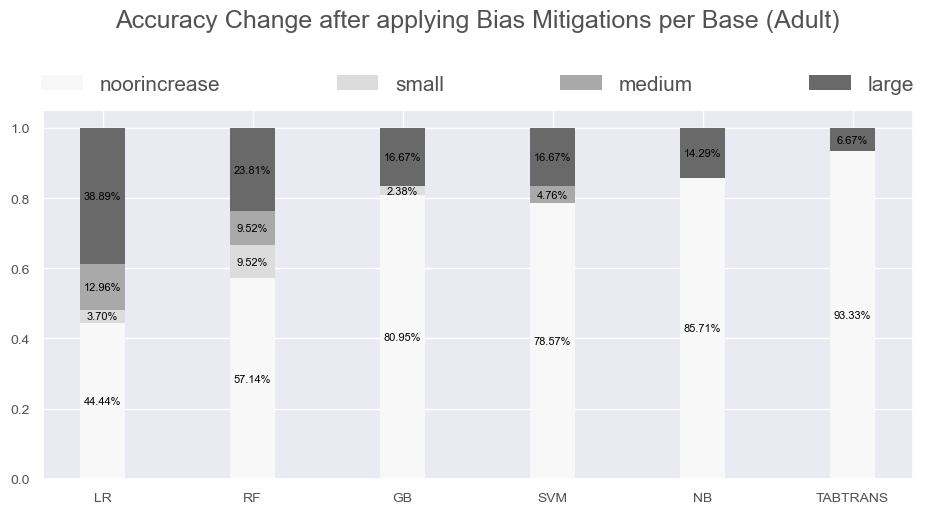

In [16]:
diff_degree, table = behaviour_analysis(data=results_all_converted, metric_list=avg_accuracy_metrics, category='base')
plot_behaviour_analysis(table, caption='Accuracy Change after applying Bias Mitigations per Base ({})'.format(data_name), figsize=(12, 6))

### Fairness Behavior After Bias Mitigations

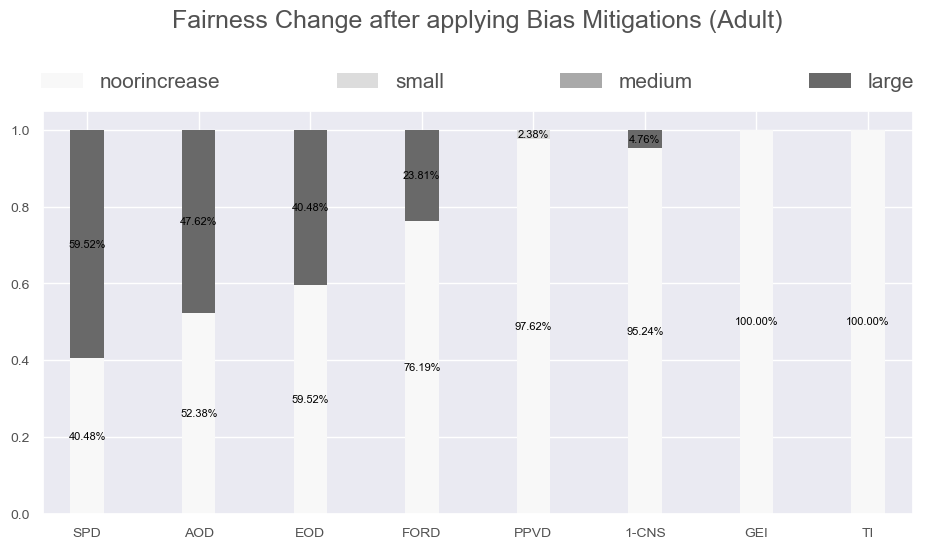

In [17]:
abs_avg_fairness_metrics = ['abs_'+ele for ele in avg_fairness_metrics]
diff_degree, table = behaviour_analysis(data=results_all_converted, metric_list=abs_avg_fairness_metrics)
plot_behaviour_analysis(table, caption='Fairness Change after applying Bias Mitigations ({})'.format(data_name), figsize=(12, 6))

### Fairness Behavior After Bias Mitigations per BM

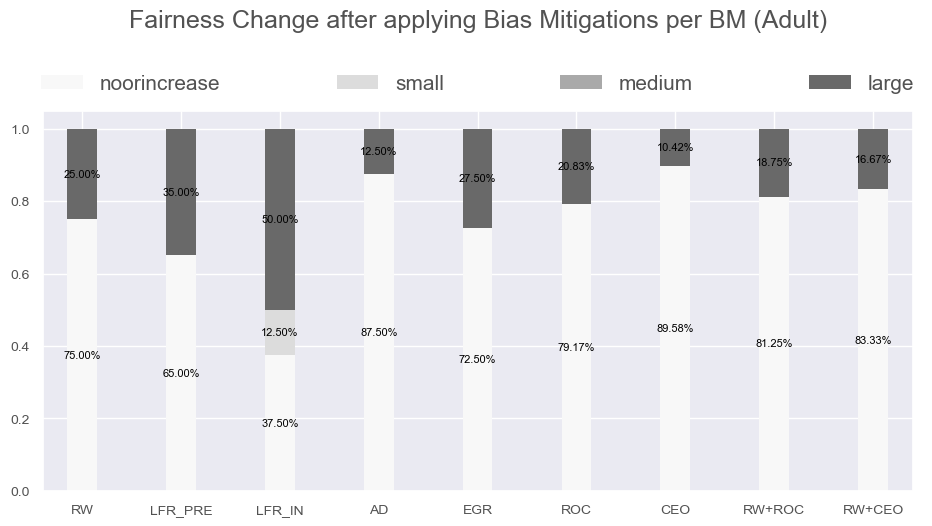

In [18]:
abs_avg_fairness_metrics = ['abs_'+ele for ele in avg_fairness_metrics]
diff_degree, table = behaviour_analysis(data=results_all_converted, metric_list=abs_avg_fairness_metrics, category='bm')
plot_behaviour_analysis(table, caption='Fairness Change after applying Bias Mitigations per BM ({})'.format(data_name), figsize=(12, 6))

### Fairness Behavior After Bias Mitigations per base

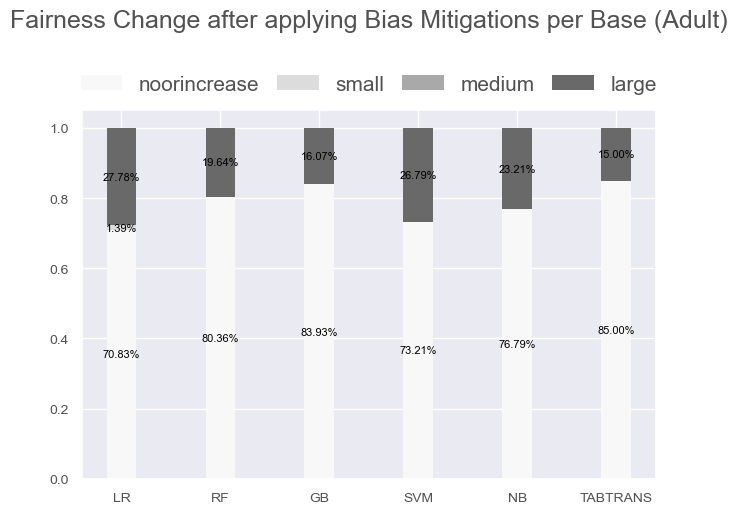

In [19]:
abs_avg_fairness_metrics = ['abs_'+ele for ele in avg_fairness_metrics]
diff_degree, table = behaviour_analysis(data=results_all_converted, metric_list=abs_avg_fairness_metrics, category='base')
plot_behaviour_analysis(table, caption='Fairness Change after applying Bias Mitigations per Base ({})'.format(data_name), figsize=(8, 6))

## Accuracy vs. Fairness

### General Results

(slope > 0: trade-off)
We can see from the graphs below:

1. Overall trend: the higher the accuracy, the lower the group fairness (positive slope)
2. But the choice of metrics does matter:
    - group fairness: ford_score showcased no "trade-offs"
    - accuracy metrics: f1_score and roc_auc_score showed milder "trade-offs"
    - same fairness metric combined with different accuracy metrics can present both positive/negative relations, vice versa

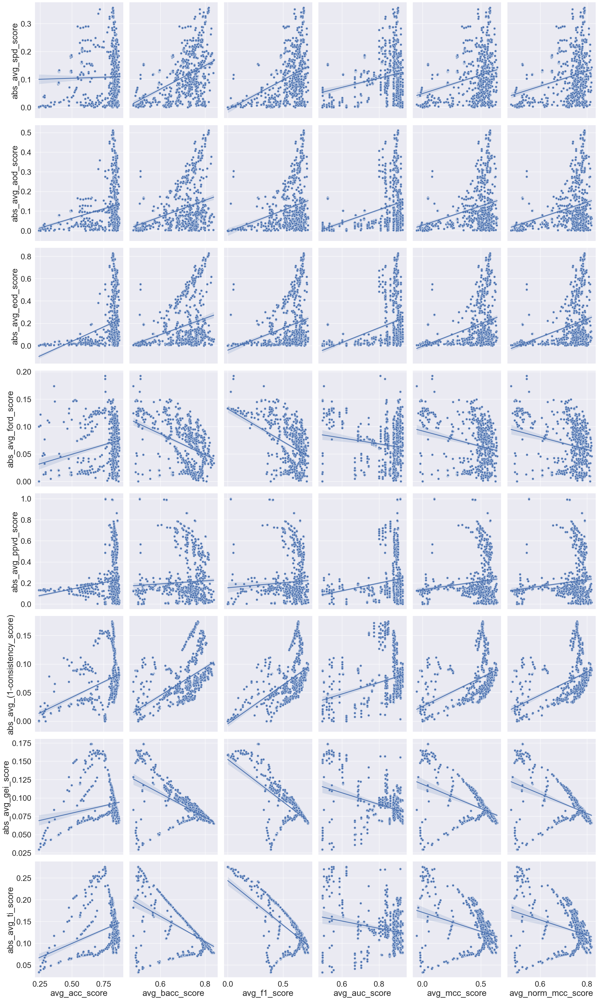

In [20]:
import matplotlib.pyplot as plt
# Set plot font
plt.rcParams.update({'font.family':'serif'})
plt.rcParams.update({'font.serif':'Times New Roman'})

sns.set(font_scale = 2)
abs_fairness_metrics = ['abs_'+col for col in avg_fairness_metrics]
g = sns.pairplot(data=results_all_converted, x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
             height=5, aspect=.8, kind="reg")
g.map(sns.scatterplot)

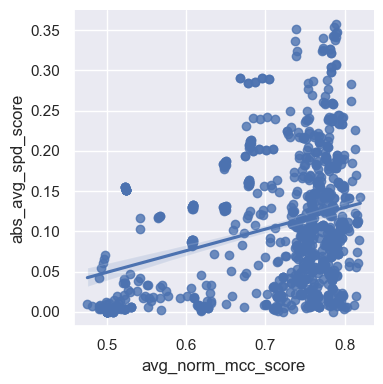

In [43]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, height=4)

### Base_estimator specific Results

We can see from the graphs below:
1. Different base_estimators can also generate very different results:
    - SVM (red) the least robust, while "NB" manifest clear trend
    - base_estimators divided into two groups when it comes to consistency_score: tree-based, ensemble (trade-offs) vs non tree-based, non ensemble

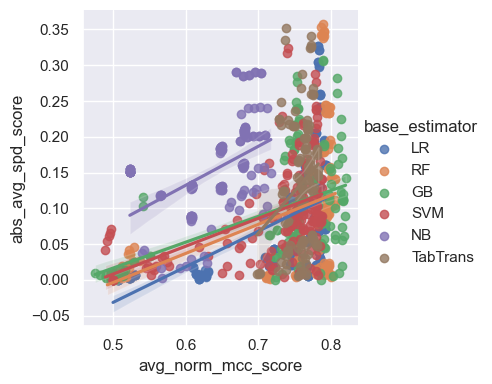

In [47]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, hue='base_estimator', 
               hue_order = ['LR','RF','GB','SVM','NB','TabTrans'], height=4)

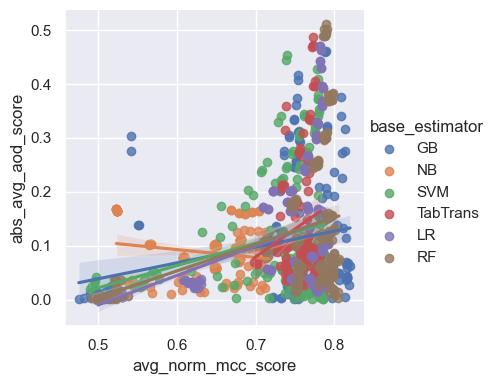

In [22]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y='abs_avg_aod_score', hue='base_estimator', height=4)

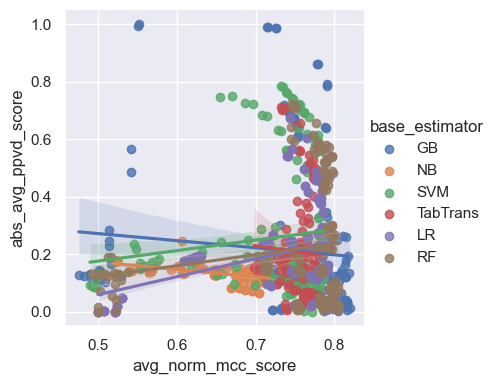

In [23]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y='abs_avg_ppvd_score', hue='base_estimator', height=4)

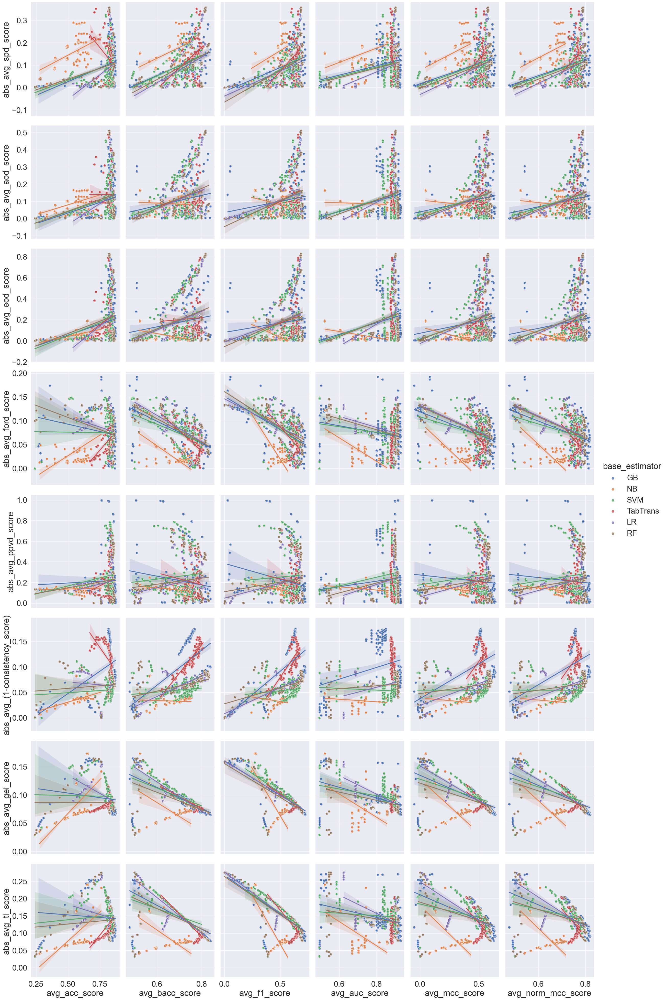

In [24]:
sns.set(font_scale = 2)
g = sns.pairplot(data=results_all_converted[results_all_converted.base_estimator!=''],
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='base_estimator')
g.map(sns.scatterplot)

GB


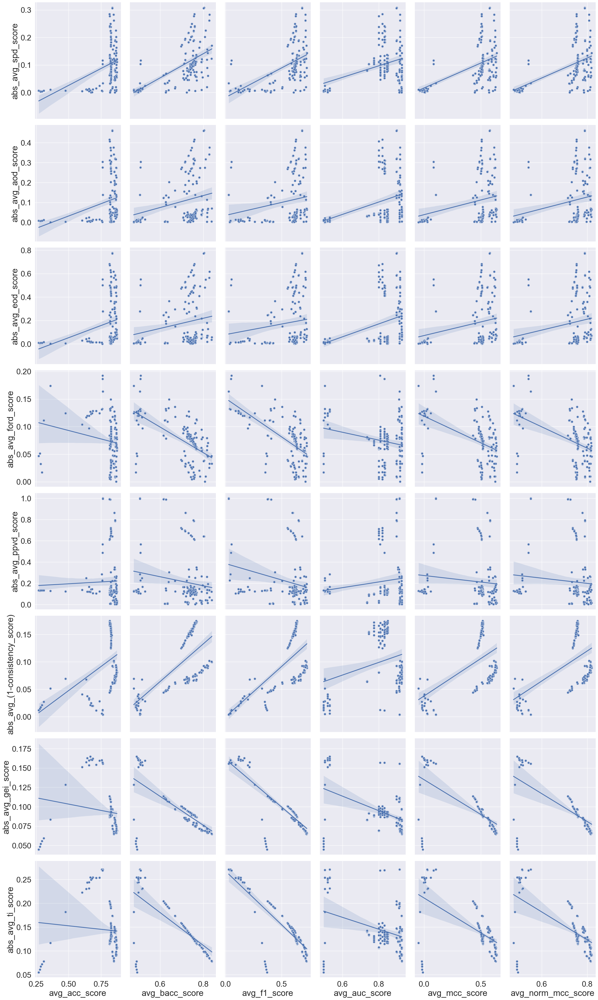

NB


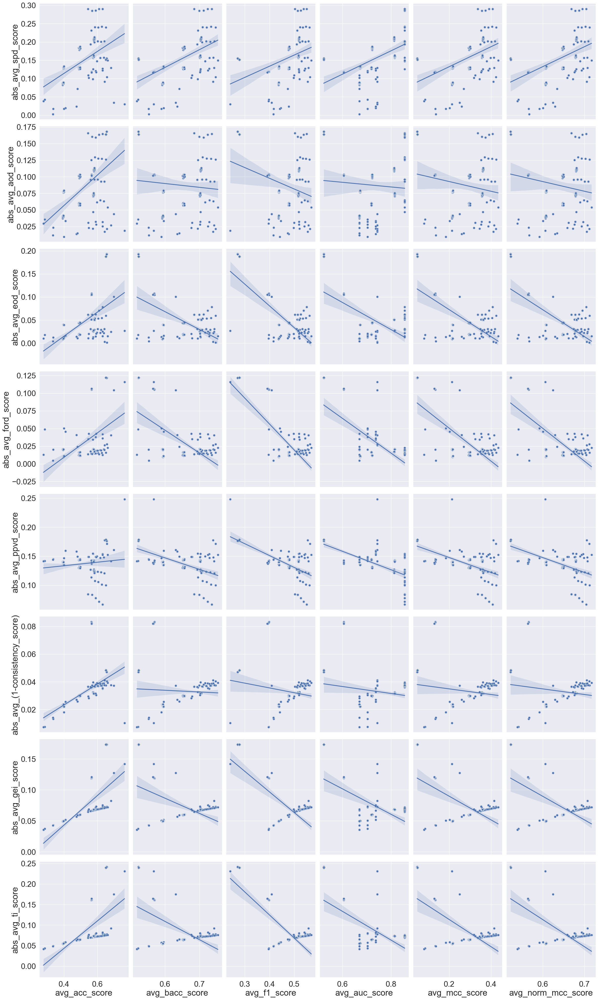

SVM


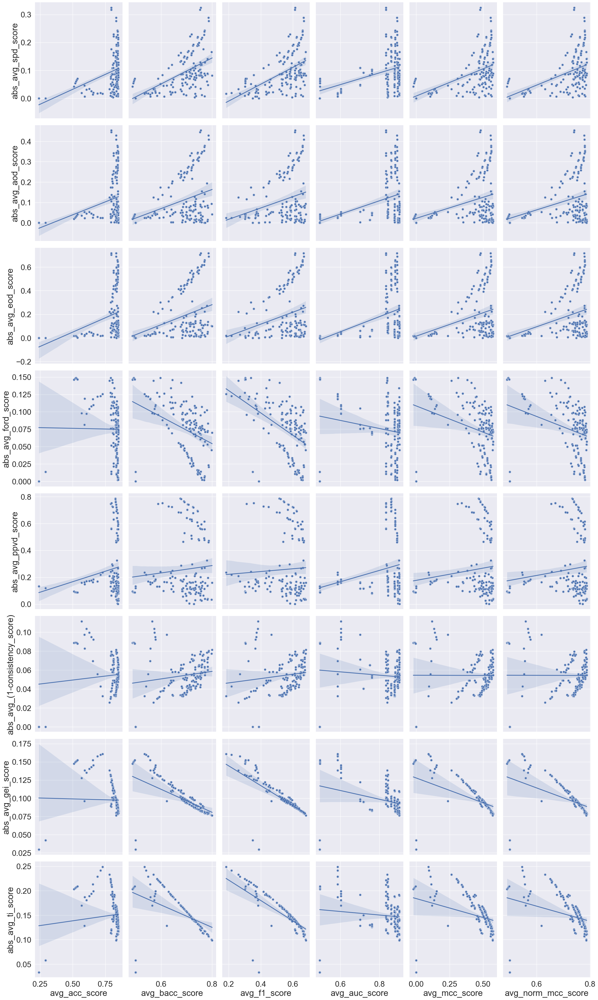

TabTrans


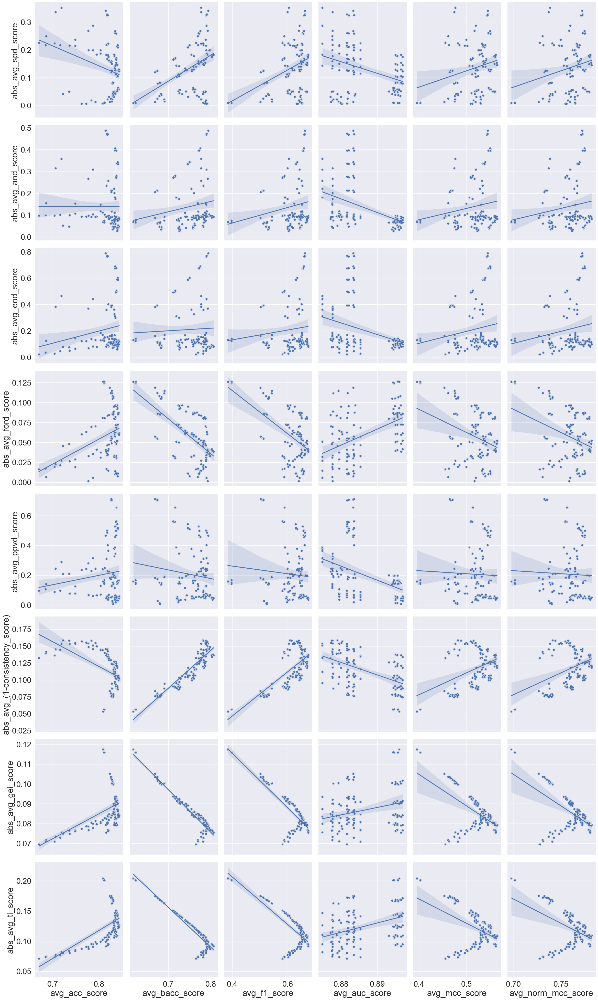

LR


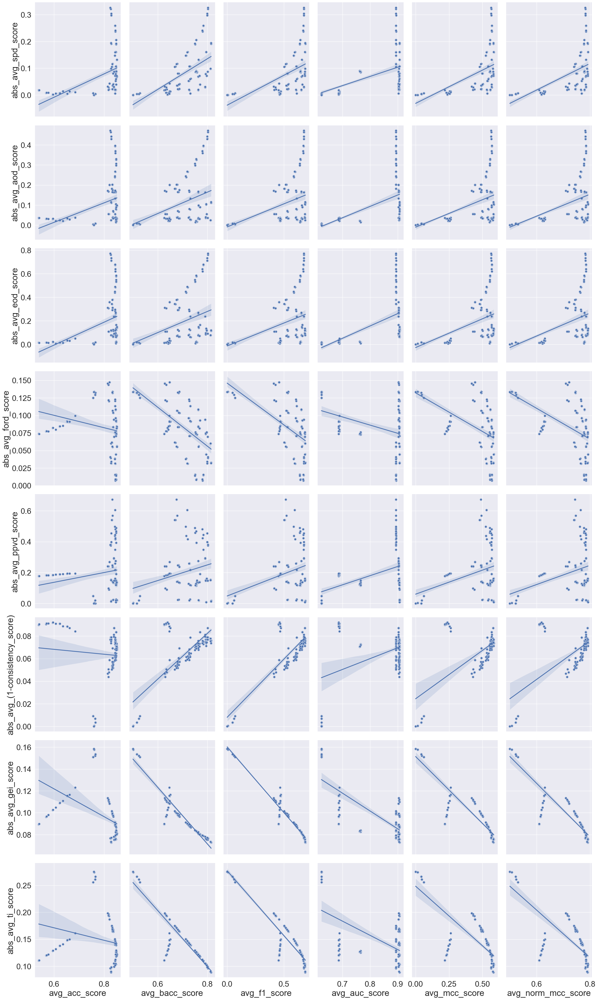

RF


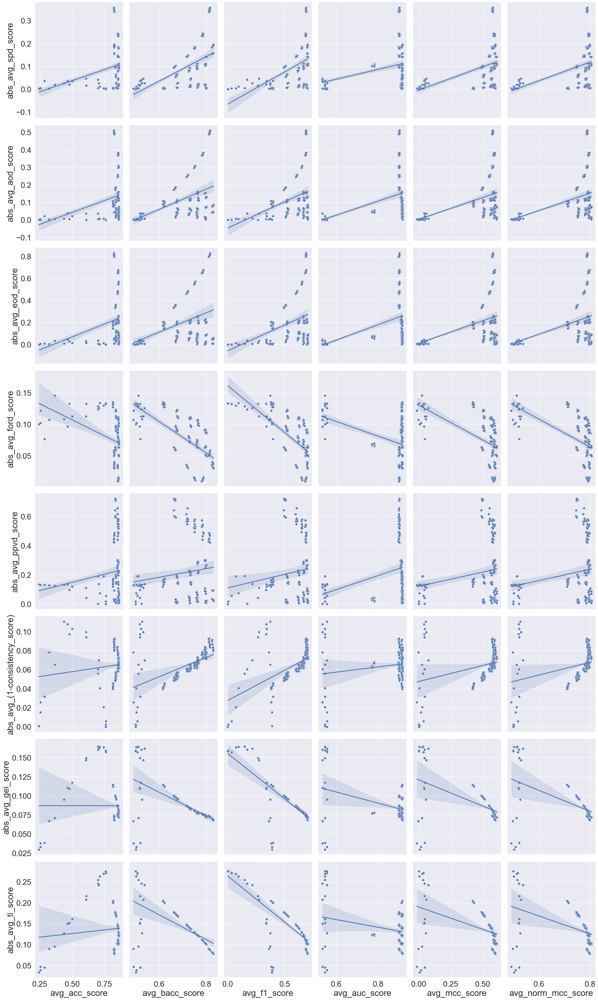

In [25]:
sns.set(font_scale = 2)
abs_fairness_metrics = ['abs_'+col for col in avg_fairness_metrics]
for base in results_all_converted.base_estimator.unique():
    print(base)
    if base=='':
        pass
    else:
        g = sns.pairplot(data=results_all_converted[results_all_converted.base_estimator==base],
                         x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                         height=5, aspect=.8, kind="reg")
        g.map(sns.scatterplot)
        plt.show()

### Threshold specific Results

We can see from the graphs below:

1. Using different threshold also yiels different results:
    - most obvious with (f1_score, group_fairness) combinations

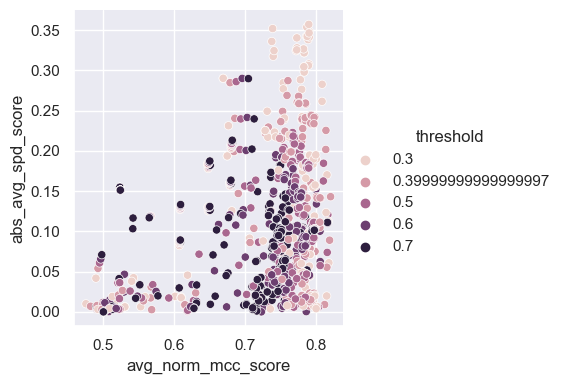

In [26]:
sns.set(font_scale = 1)
g = sns.relplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, hue='threshold', height=4)

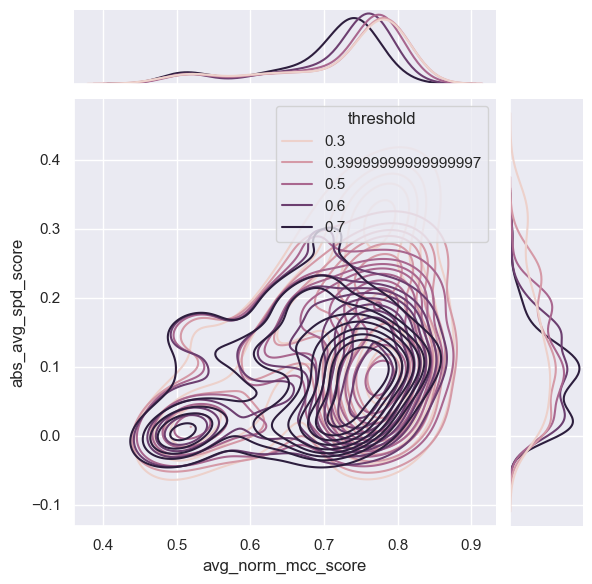

In [27]:
sns.jointplot(
    data=results_all_converted.reset_index(drop=True),
    x=ACC_METRIC, y=FAIR_METRIC, hue="threshold",
    kind="kde")

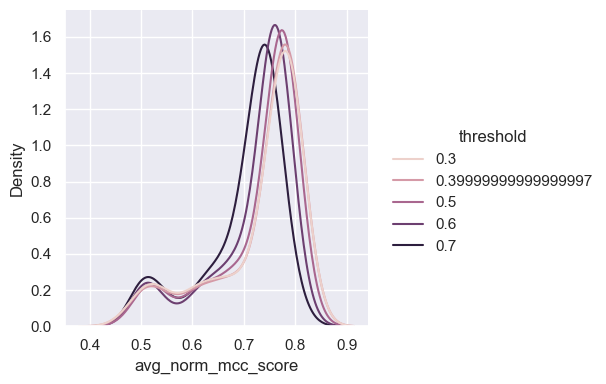

In [28]:
sns.set(font_scale = 1)
g = sns.displot(data=results_all_converted.reset_index(drop=True), kind="kde", x=ACC_METRIC, hue='threshold', height=4)

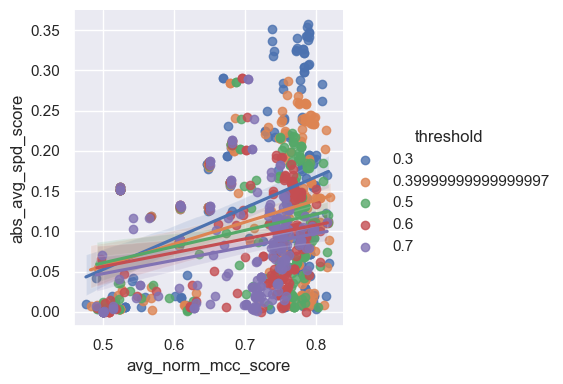

In [29]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, hue='threshold', height=4)

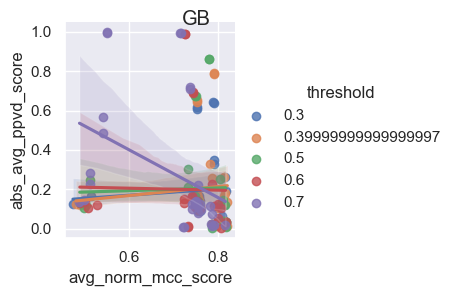

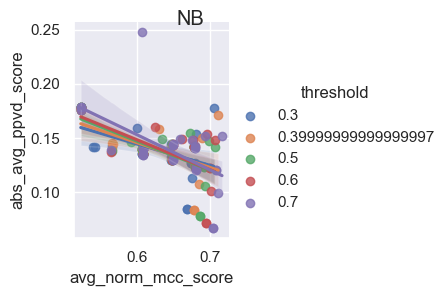

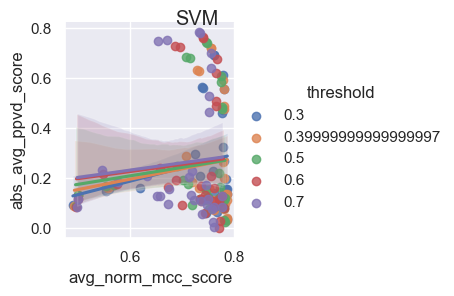

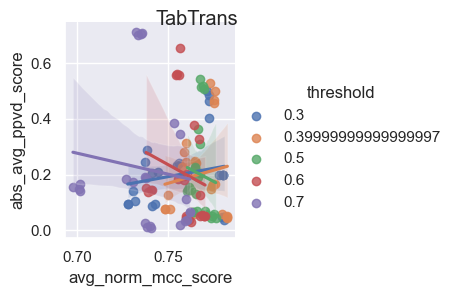

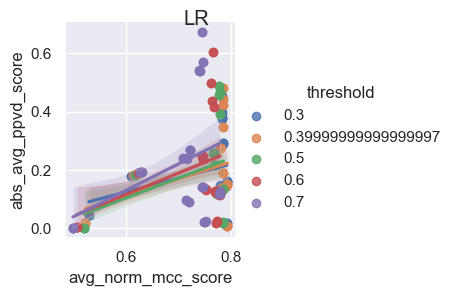

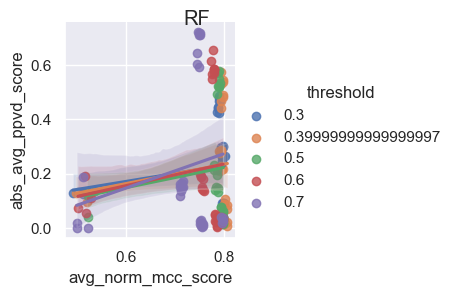

In [30]:
sns.set(font_scale = 1)
for base in results_all_converted.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x="avg_norm_mcc_score", y="abs_avg_ppvd_score", hue="threshold", height=3).fig.suptitle(base)

### Bias_mitigation specific Results

We can see from the graphs below:

1. Results are clearly divided into two groups
2. Generally with wide C.I.

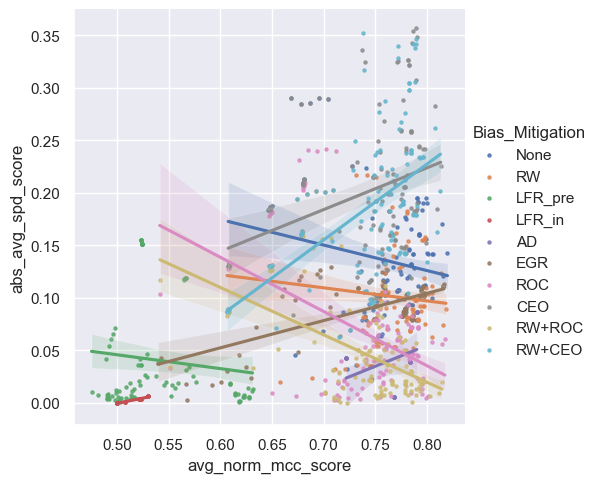

In [49]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, hue='Bias_Mitigation', 
               hue_order=['None','RW','LFR_pre','LFR_in','AD','EGR','ROC','CEO','RW+ROC','RW+CEO'],
               scatter_kws={'s': 5}, height=5)

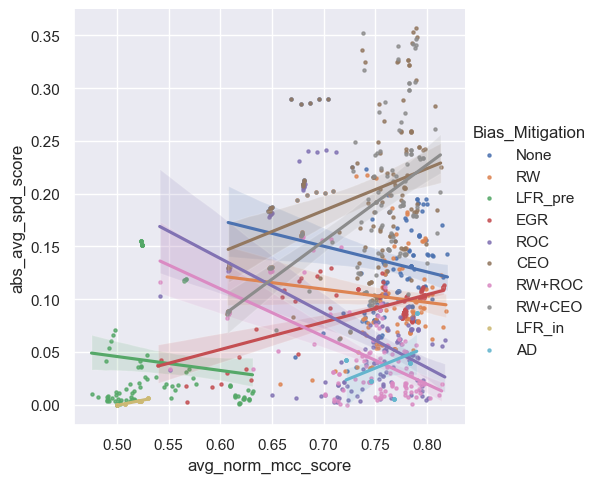

In [31]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y='abs_avg_spd_score', hue='Bias_Mitigation', 
               scatter_kws={'s': 5}, height=5)

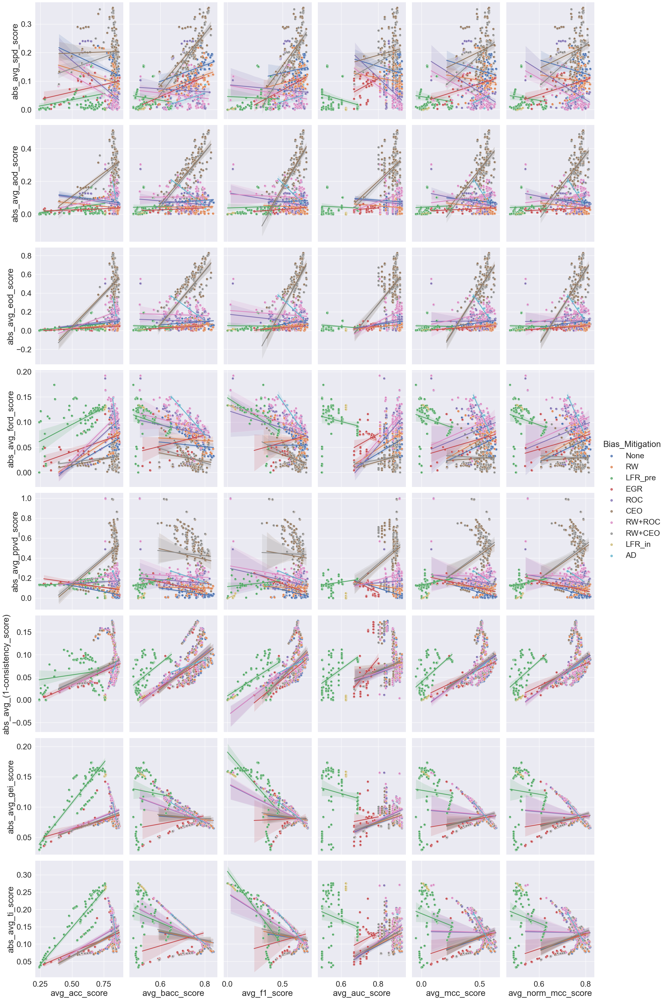

In [33]:
sns.set(font_scale = 2)
g = sns.pairplot(data=results_all_converted,
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='Bias_Mitigation')
plt.legend(fontsize='10')
g.map(sns.scatterplot)

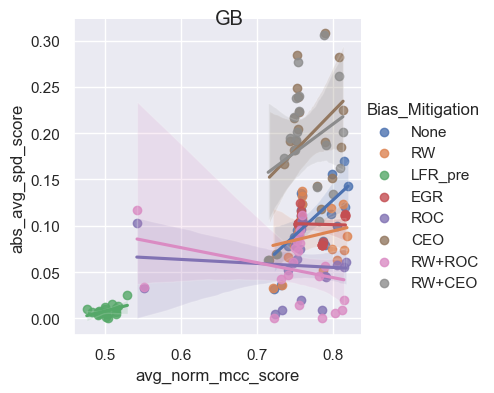

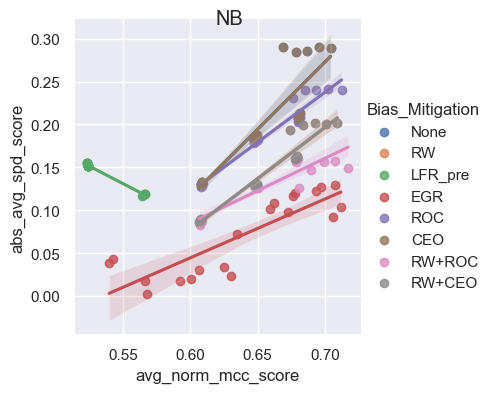

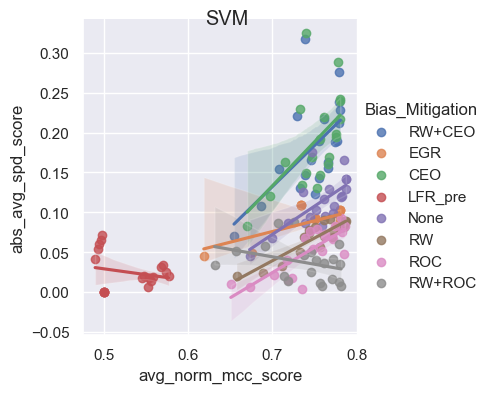

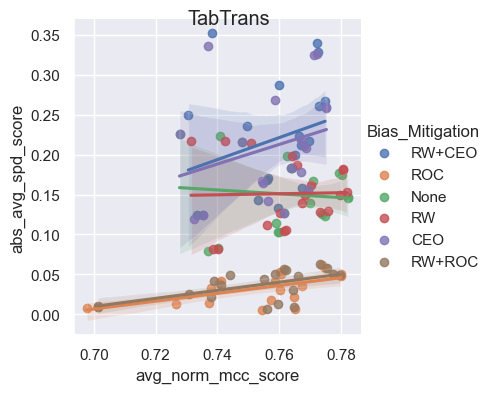

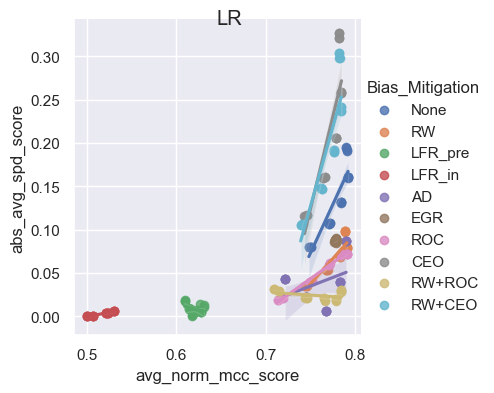

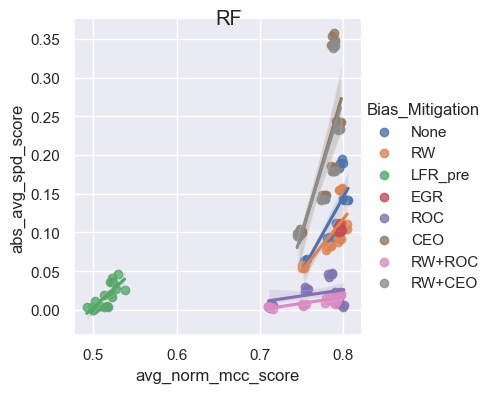

In [34]:
sns.set(font_scale = 1)
for base in results_all_converted.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x=ACC_METRIC, y=FAIR_METRIC, hue="Bias_Mitigation", height=4).fig.suptitle(base)

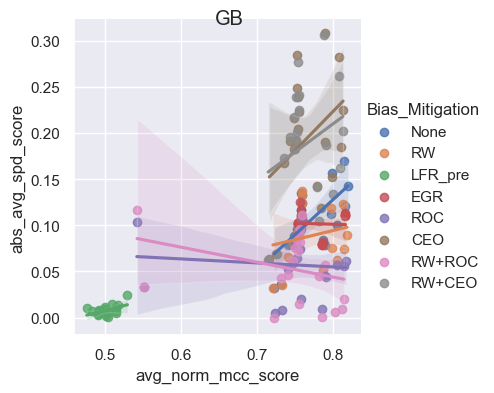

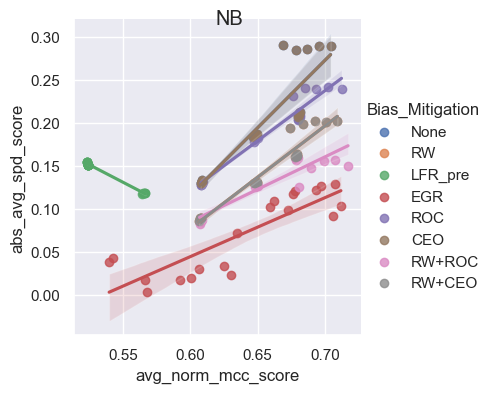

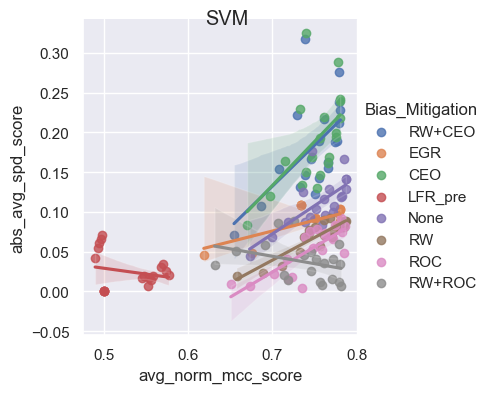

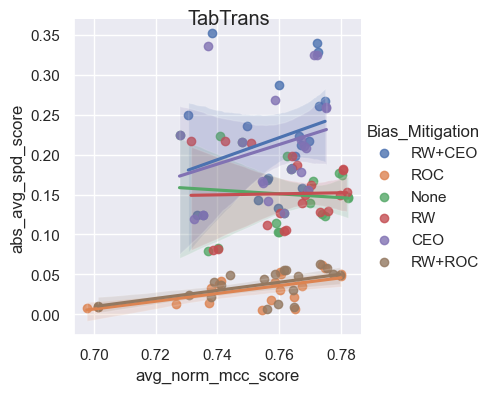

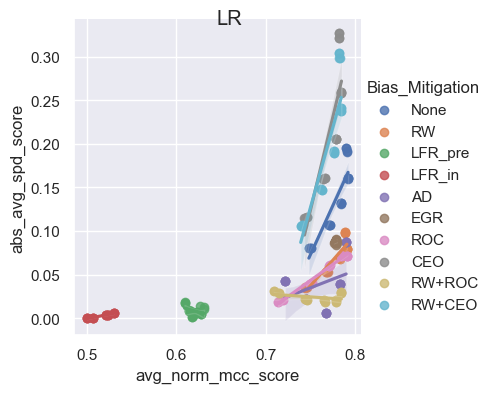

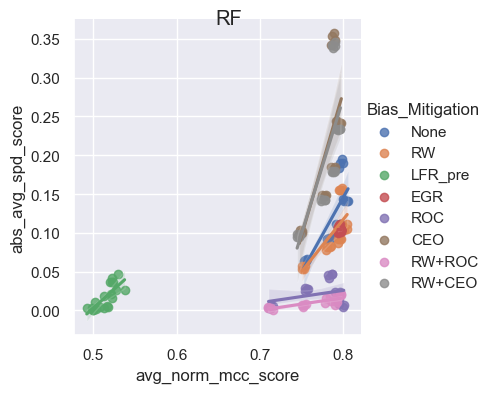

In [35]:
sns.set(font_scale = 1)
for base in results_all_converted.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x=ACC_METRIC, y='abs_avg_spd_score', hue="Bias_Mitigation", height=4).fig.suptitle(base)

### Bias Mitigation Category

In [36]:
bm_category = {'PRE':['RW', 'LFR_pre'],
               'IN': ['LFR_in','AD','EGR'],
               'POST':['ROC','CEO'],
               'PRE+POST':['RW+ROC','RW+CEO']}

In [37]:
results_all_converted['BM_Category'] = results_all_converted['Bias_Mitigation'].replace({v: k for k, l in bm_category.items()\
                                                                                         for v in l})
results_all_converted[['Bias_Mitigation','BM_Category']].drop_duplicates()

,Bias_Mitigation,BM_Category
0,None,None
5,RW,PRE
10,LFR_pre,PRE
15,EGR,IN
20,ROC,POST
25,CEO,POST
30,RW+ROC,PRE+POST
35,RW+CEO,PRE+POST
15,LFR_in,IN
20,AD,IN


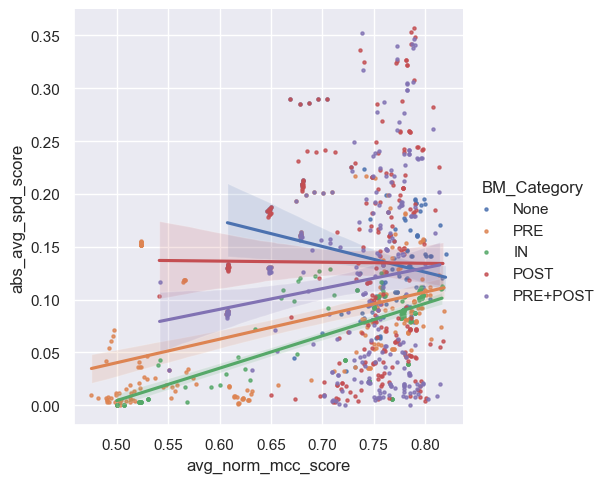

In [48]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, hue='BM_Category', 
               scatter_kws={'s': 5}, height=5)

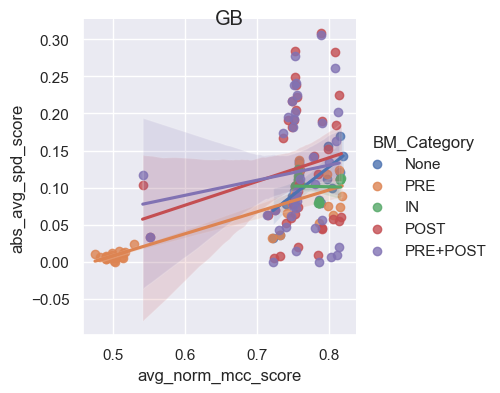

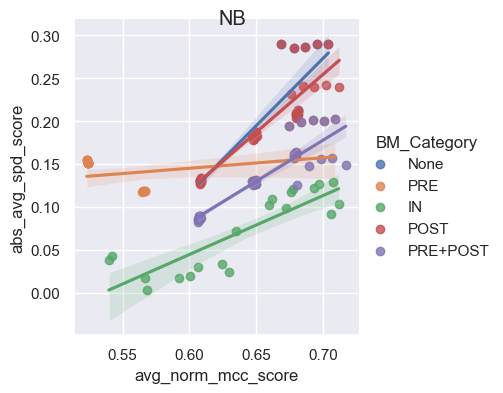

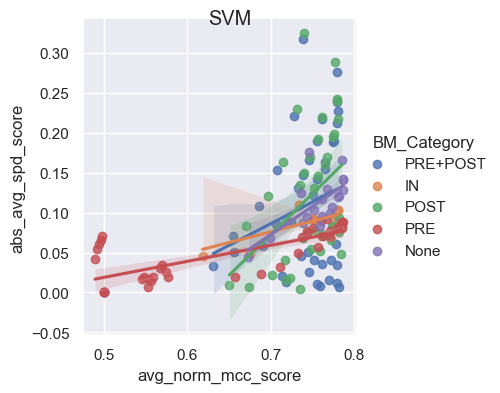

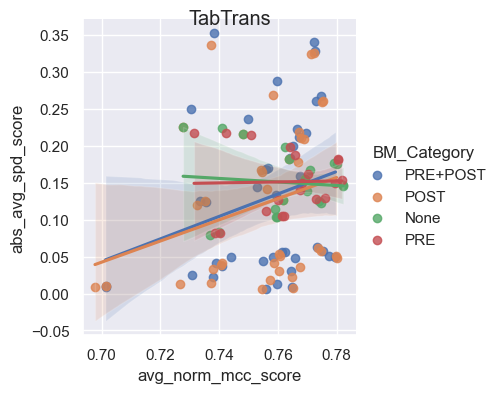

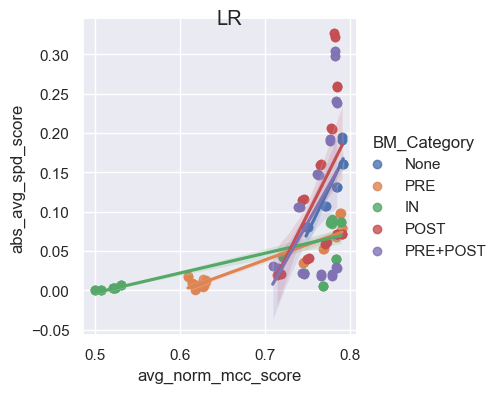

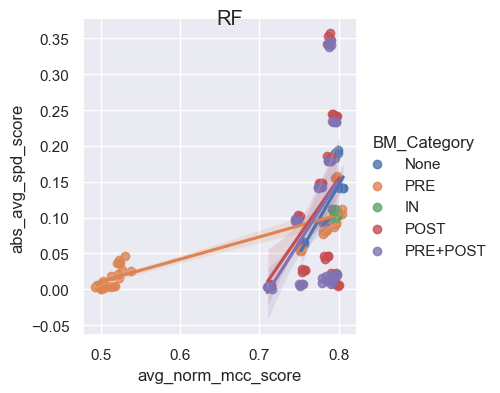

In [38]:
sns.set(font_scale = 1)
for base in results_all_converted.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x=ACC_METRIC, y=FAIR_METRIC, hue="BM_Category", height=4).fig.suptitle(base)

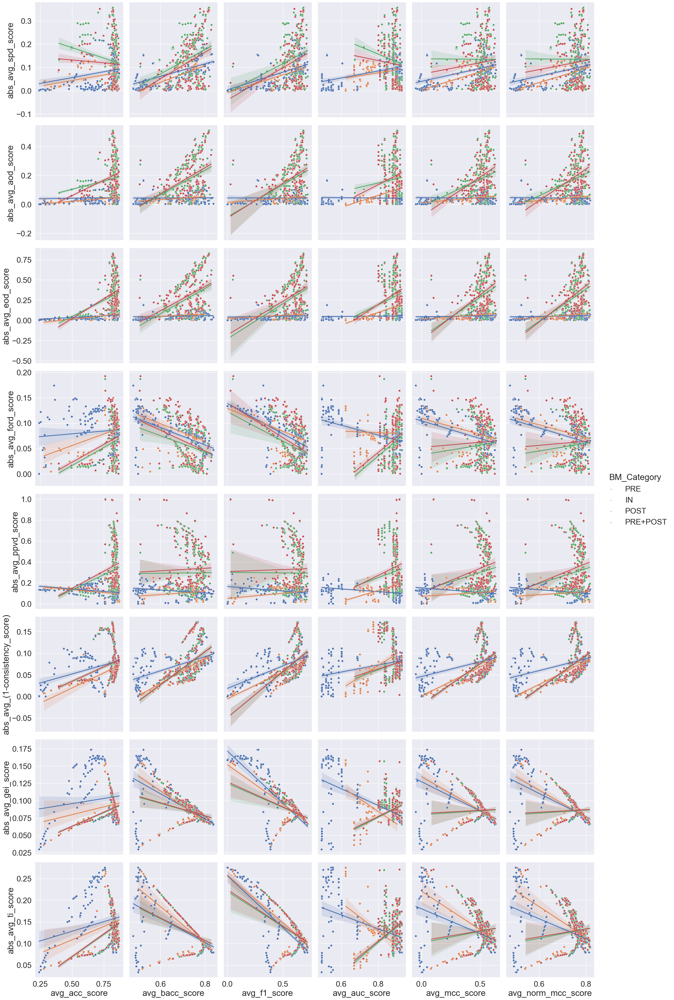

In [39]:
sns.set(font_scale = 2)
g = sns.pairplot(data=results_all_converted[results_all_converted.BM_Category!='None'],
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='BM_Category', plot_kws={'scatter_kws': {'s': 2}})
g.map(sns.scatterplot)

## Group vs. Individual Fairness

No clear trend between group and individual fairness with a few exceptions

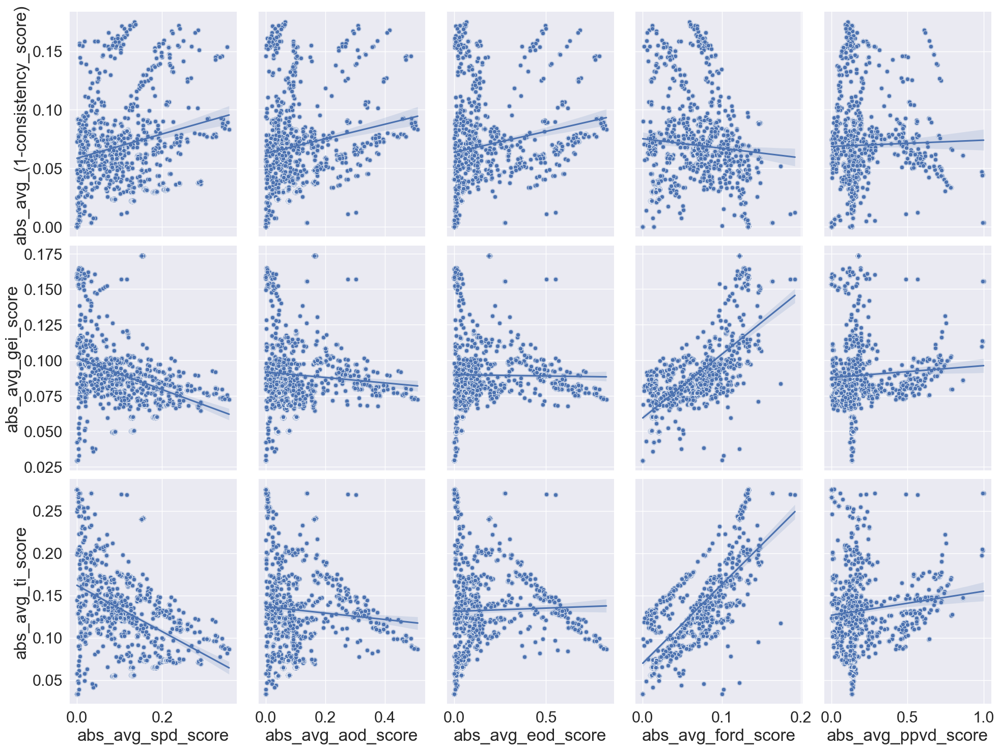

In [40]:
g = sns.pairplot(data=results_all_converted,
                 x_vars=['abs_avg_'+col for col in group_fairness], y_vars=['abs_avg_'+col for col in individual_fairness],
             height=5, aspect=.8, kind="reg")
g.map(sns.scatterplot)

### Heatmap

<AxesSubplot:>

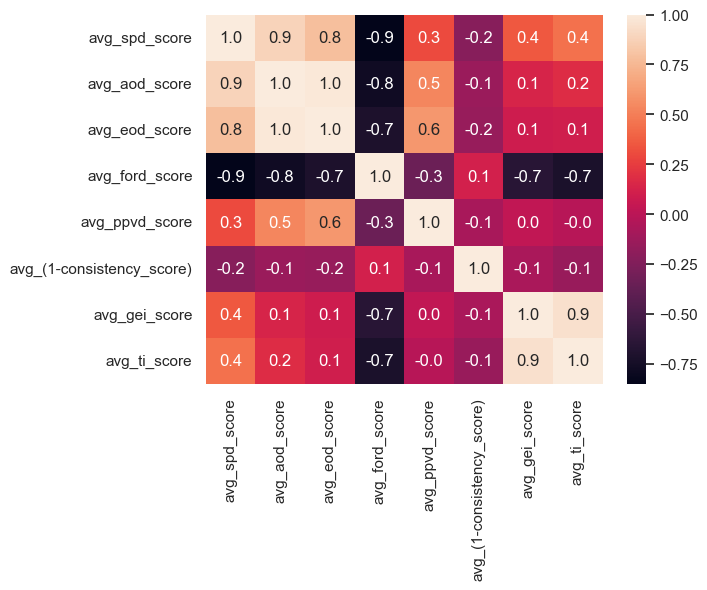

In [41]:
sns.set(font_scale = 1)
# avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
# avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]
sns.heatmap(results_all_converted[avg_fairness_metrics].corr(), annot=True, fmt=".1f")

<AxesSubplot:>

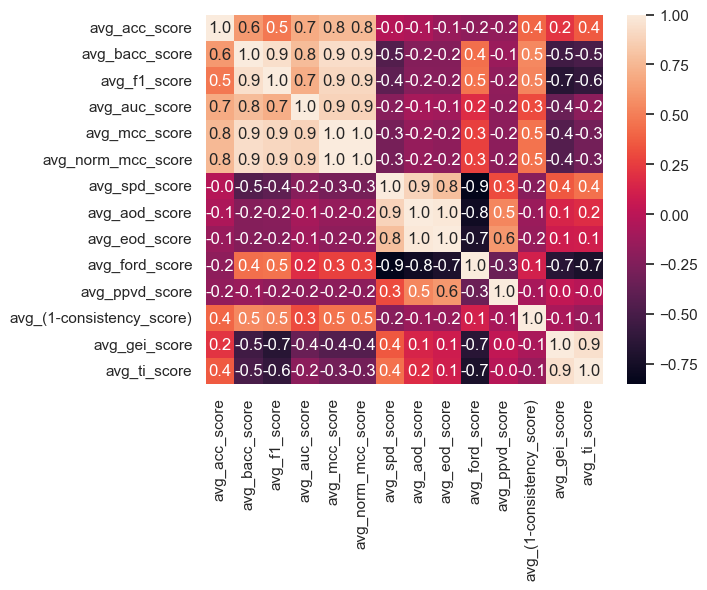

In [42]:
sns.set(font_scale = 1)
# avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
# avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]
sns.heatmap(results_all_converted[avg_accuracy_metrics+avg_fairness_metrics].corr(), annot=True, fmt=".1f")